# [IAPR 2019:][iapr2019] Special project

**Group members:**
    1- first name and last name,
    2- first name and last name,
    3- first name and last name

**Due date:** 30.05.2019

[iapr2019]: https://github.com/LTS5/iapr-2019


## Description
Please find the description of this special project via [this link].

[this link]: https://github.com/LTS5/iapr-2019/blob/master/project/special_project_description.pdf

## Part 1: Finding varroas by segmentation
Add your implementation for ''**detect_by_segmentation**'' function. Please make sure the input and output follows the mentioned format.

In [1]:
import os
import cv2
import random
import skimage.io
import skimage.morphology

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches

from skimage import color
from skimage.measure import label, regionprops

We start by importing the images

In [2]:
def get_images_fct(DATA_PATH,IMAGE_PATH,PATH, df_data, greyscale=False):
    '''
    Returns a list of images
    '''
    PATH = DATA_PATH+IMAGE_PATH+PATH
    im_names = df_data.filename.unique()
    filenames = [os.path.join(PATH, name) + '.jpg' for name in im_names]
    images = skimage.io.imread_collection(filenames)
    print('Number of images: ', len(images))
    if greyscale:
        grey_images = []
        for im in images:
            grey_images.append(color.rgb2gray(im))
        images = grey_images
    return images

In [3]:
# Load images
DATA_PATH = "./project-data"
IMAGE_PATH = "/images"
TRAIN_PATH = "/train"
TEST_PATH = "/test"
VALIDATION_PATH = "/validation"

train_data = pd.read_pickle("df_train.pickle")
test_data = pd.read_pickle("df_test.pickle")
val_data = pd.read_pickle("df_val.pickle")

train_images = get_images_fct(DATA_PATH,IMAGE_PATH, TRAIN_PATH, train_data, False)
test_images = get_images_fct(DATA_PATH,IMAGE_PATH, TEST_PATH, test_data, False)
val_images = get_images_fct(DATA_PATH,IMAGE_PATH, VALIDATION_PATH, val_data, False)

Number of images:  532
Number of images:  33
Number of images:  103


Due to the high variety of settings and camera, we will start by normalizing and transforming each image to fit the best RGB distribution. During Lab 01, we noticed that the 4th image lead to very good results, hence we will set this one as the distribution target. 

We start by importing the four images of Lab 01

In [4]:
#first, get the 4th image of lab one
LAB_DATA_PATH = "./lab-01-data"
im_names = ['varroa-01', 'varroa-02', 'varroa-03', 'varroa-04']
filenames = [os.path.join(LAB_DATA_PATH, name) + '.jpg' for name in im_names]
ic = skimage.io.imread_collection(filenames)
print('Number of images: ', len(ic))

Number of images:  4


In [5]:
import xml.etree.ElementTree as ET

def parse_file(filename):
    """ Parse a PASCAL VOC xml file """
    tree = ET.parse(filename)
    objects = []
    for obj in tree.findall('object'):
        obj_struct = {}
        obj_struct['name'] = obj.find('name').text
        bbox = obj.find('bndbox')
        obj_struct['bbox'] = [int(float(bbox.find('xmin').text)),
                              int(float(bbox.find('ymin').text)),
                              int(float(bbox.find('xmax').text))-int(float(bbox.find('xmin').text)),
                              int(float(bbox.find('ymax').text))-int(float(bbox.find('ymin').text))]
        objects.append(obj_struct)

    return objects

annotations_xmls = [parse_file(os.path.join(LAB_DATA_PATH, name) + '.xml') for name in im_names]

In [6]:
#get RGB means of 4th image
r_mean = ic[3][:,:,0].mean()
print("Red mean of image 4 is ", np.round(r_mean,2))
g_mean = ic[3][:,:,1].mean()
print("Green mean of image 4 is ", np.round(g_mean,2))
b_mean = ic[3][:,:,2].mean()
print("Blue mean of image 4 is ", np.round(b_mean,2))

target_mean = [r_mean, g_mean, b_mean]

Red mean of image 4 is  236.8
Green mean of image 4 is  240.36
Blue mean of image 4 is  238.6


In [7]:
def normalise_colors_values(image, target):
    '''
    nomalizes images distribution across RGB channels to match target and returns the normalized image
    '''
    new_im = np.ones_like(image).astype(float)
    for i in range(3):
        mean = image[:,:,i].mean()
        new_im[:,:,i] = (target[i]/mean) * image[:,:,i]
        new_im = new_im.astype(int)
        new_im[new_im > 255] = 255
    return new_im

Looking at the images where the classifier was performing poorly, we identified that some were displaying grass. Hence, we want to make grass appear white in grayscale, as the background. As a result, we coded a rgb2gray function where the green channel as a very high value, hence transforming green objects to white. Additionnaly, we know that the varoa have a bit of red when backlit, hence we give a very low value to the red channel, making it appear dark in grayscale. <br>
After a few tests, we identified the following transformation to give the best results.

In [8]:
def rgb2gray(rgb):
    '''
    converts image to RGB (opencv.color had weird behaviour with norm_image)
    '''
    r, g, b = rgb[:,:,0], rgb[:,:,1], rgb[:,:,2]
    #values optimized on training set
    r_r = 0.05
    r_g = 0.90
    r_b = 0.05
    
    gray = r_r * r + r_g * g + r_b * b
    
    return gray.astype(int)

We re-used and modified slightly our function of Lab 01 created bounding boxes and anaylizing the results

In [9]:
def create_bounding_boxes(image):
    '''
    Returns bounding boxes from labeled image
    '''
    regions = []
    for region in regionprops(image):
        # take regions with large enough areas
        if region.area >= 70:
            # draw rectangle around segmented coins
            regions.append(region)  
    return regions  

In [10]:
def detect_by_segmentation(img, threshold, filter1, filter2):
    '''
    Input: One single image
    Output: A numpy array containing coordonates of all detected varroas, with the following format: 
            [[x_1, y_1, w_1, h_1], [x_2, y_2, w_2, h_2], ..., [x_n, y_n, w_n, h_n]] 
            where ''n'' is the number of detected varroas.
    '''
    #Setting targets
    target_mean = [236.8, 240.36, 238.6]
    #normalizing images for good result
    norm_img = normalise_colors_values(img, target_mean)
    #grayscale image
    grayscale_img = rgb2gray(norm_img)
    #thresholding
    threshold_img = np.invert(grayscale_img < threshold)
    #filtering
    filtered_img = skimage.filters.median(threshold_img, selem=np.ones((filter1,filter1)))
    #opening
    opened_img = skimage.morphology.binary_opening(filtered_img, selem=np.ones((filter2,filter2)))
    #label images
    background_val= grayscale_img.max()
    labeled,b = skimage.measure.label(opened_img, return_num=True, connectivity=2, background=background_val)
    #create bounding boxes
    regions = create_bounding_boxes(labeled.copy())
    #extract_bounding boxes
    boxes = [] 
    for box in regions[1:]:
        minr, minc, maxr, maxc = box.bbox
        #keeping only relevant sizes
        if (((maxc-minc)* (maxr-minr)) < 600) and (((maxc-minc)* (maxr-minr)) > 120):
            boxes.append([minc, minr, maxc-minc, maxr-minr])
    return np.asarray(boxes)

Add your implementation. Report the Precision, Recall and F1-score, by using all 50 images of the test-set, and considering 0.3 as the IoU threshold.

In [11]:
def bb_intersection_over_union(boxA_old, boxB):
    '''
    Given two bounding boxex, calculates IoU
    
    args:
    boxA [int, int, int, int] : [x, y, w, h]
    boxB [int, int, int, int]: [x, y, x_f, y_f]
    
    output:
    IoU (float) : IoU of boxA and boxB
    '''
    #modify boxA to fit boxB 
    boxA = boxA_old.copy()
    boxA[2] = boxA[0] + boxA[2]
    boxA[3] = boxA[1] + boxA[3]
    # determine the (x, y)-coordinates of the intersection rectangle
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])

    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])
    # compute the area of intersection rectangle
    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)
    if interArea > 0:
        # compute the area of both the prediction and ground-truth
        # rectangles
        boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
        boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)

        # compute the intersection over union by taking the intersection
        # area and dividing it by the sum of prediction + ground-truth
        # areas - the interesection area
        iou = interArea / float(boxAArea + boxBArea - interArea)
        # return the intersection over union value
    else :
        iou = 0
    return iou

In [12]:
def IoU_bbox(detected, ground_truth):
    '''
    Creates a matrix with rows corresponding to the detected objects and the columns 
    corresponding to the ground_truth. The i,j element of the matrix correspond to the IoU
    score between the detected box i and the gorund truth j.
    An additional column is added (last position) to represent the detect boxes that
    do not match any ground truth (their score is -1)
    An additional row is added (last position) correponding to the ground-truth that 
    do not intersect with any detected ones (their score is -2).
    
    args:
    detected : detected boxes
    ground_truth : the ground_truth boxes.
    
    returns:
    matrix of IoU scores.
    '''
    nb_detected = len(detected)
    nb_true = len(ground_truth)
    iou_matrix = np.zeros((nb_detected+1, nb_true+1)).astype(float)

    #for each detected box, go over all true boxes
    for i in range(nb_detected) :
        detected_box = detected[i]
        for j in range(nb_true):  
            region = ground_truth[j]
            #modyfying bbox of true to satisfy bbox format or regionprop
            bbox_modified = [region[0], region[1], \
                             region[2], region[3]]
            #calculates IoU
            iou = bb_intersection_over_union(detected_box, bbox_modified)
            iou_matrix[i,j] = iou
        #last column is -1: detected but not ground-truth : false positives    
        #if iou_matrix.sum(axis=1)[i] == 0:
        if sum(iou_matrix[i,:])==0:
            iou_matrix[i,j+1] = -1
    
    #last row is -2: ground-truth but not detected: false negative       
    iou_matrix[-1, [iou_matrix.sum(axis=0) == 0][0]] = -2
    
    #element at 'false postive' and 'false negative' column intersection
    iou_matrix[-1,-1] = 0
    return iou_matrix


In [13]:
def precision_recall_f_score(iou_matrix, threshold, found_boxes, true_boxes):
    '''
    From matrice calculates TP, FP and FN rates for all images for a given threshold and plot
    the boxes given if asked.
    
    ARGS
    iou_matrix |np.array|       : contains values of IoB boxes for each found and real boxes
    threhold |float|            : IoU threshold given
    found_boxes |list|          : list regioprops corresponding to the boxes found
    true_boxes  |list|          : list of dict cotaining real boxes
    
    RETURNS
    dataframe: |panda dataframe| precision, recall and f1 for each image
    
    '''
    dataframe=pd.DataFrame(columns=["Values"])


    #where the IoU score is above the threshold
    true_positives_boxes = np.argwhere(iou_matrix > threshold)

    #gets the box with insufficient intersection score or ground truth that
    #do not intersect with a detected one (= -2 in the matrix)
    false_negatives_boxes = np.argwhere(((iou_matrix>0) & (iou_matrix<threshold))  | (iou_matrix == -2))

    #get rid of element that have a higher IoU score with other boxes
    false_negatives_boxes= [box for box in false_negatives_boxes if box not in true_positives_boxes]


    false_positives_boxes = np.argwhere(iou_matrix == -1)

    #calculating the rates
    tp = len(true_positives_boxes)
    fp = len(false_positives_boxes)
    fn = len(false_negatives_boxes)

    #statistics
    if tp+fp !=0:
        precision = tp/(tp+fp)
    else:
        precision=0
    if tp+fn !=0:    
        recall = tp/(tp+fn)
    else:
        recall = 0
    if (precision+recall) != 0 :
        f1 = 2*(precision*recall)/(precision+recall)
    else:
        f1 = 0

    dataframe.loc['F1']=f1
    dataframe.loc['Precision']=precision
    dataframe.loc['Recall']=recall
    return dataframe

We used the following function to identify the best values for treshold and filter sizes in the training and validation sets

In [14]:
def test_values(im, annot, threshold_value=0, f1_value=0, f2_value=0, plot=False, rand=False):
    '''
    Test values for different threshold and filter size
    '''
    IOU_THRESHOLD = 0.3
    # generate random values, used to test the best range in a random search
    if rand:
        threshold_value = random.randint(60,80)
        f1_value = random.randint(13,17)
        f2_value = random.randint(16,20)
    
    
    detected_boxes = detect_by_segmentation(im, threshold_value, f1_value, f2_value)
    real_boxes = annot[["xmin","ymin", "xmax", "ymax"]].values.tolist()
    
    if plot:
        fig, axes = plt.subplots(1, 1, figsize=(18, 18))
        axes.imshow(rgb2gray(im), cmap="gray")
        for anno in real_boxes:
            rect = patches.Rectangle((anno[0], anno[1]), anno[2]-anno[0], anno[3]-anno[1],
                                    linewidth=1,edgecolor='r',facecolor='none')
            axes.add_patch(rect)
        for anno in detected_boxes:
            rect = patches.Rectangle((anno[0], anno[1]), anno[2], anno[3],
                                    linewidth=1,edgecolor='b',facecolor='none')
            axes.add_patch(rect)
            
    iou_matrix = IoU_bbox(detected_boxes, real_boxes)
    
    performances = precision_recall_f_score(iou_matrix, IOU_THRESHOLD, detected_boxes, real_boxes)
    performances.loc["threshold"] = threshold_value
    performances.loc["f1_val"] = f1_value
    performances.loc["f2_val"] = f2_value
    return performances

#### We find the best parameters (threshold, filter sizes) on the training set with a random search

In [15]:
train_perf = pd.DataFrame(columns=['init'], index=["F1", "Precision", "Recall", "threshold", "f1_val", "f2_val"])
images_names = train_data.filename.unique()
for i in range(0,532):
    train_perf[str(i)] = test_values(train_images[i], train_data[train_data['filename'].str.match(images_names[i])],\
                                     plot=False, rand=True)

We identified the best values to be 75 for threshold,  15 by 15 filter for the median filter and a 19 by 19 opening element.

In [16]:
train_results_df = pd.DataFrame([train_perf.mean(1)[:3],train_perf.std(1)[:3]], \
                                index=["Mean Train", "Std Train"]).T
train_results_df.head()

,Mean Train,Std Train
F1,0.322780,0.298572
Precision,0.303878,0.314997
Recall,0.482901,0.373524


Let's look at the worst 20 performing images

In [18]:
train_perf.sort_values("F1", axis=1).iloc[:,:20]

,0,126,128,129,130,131,357,354,125,350,340,333,147,330,149,329,328,343,366,372
F1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
Precision,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
Recall,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
threshold,78,62,60,75,70,79,74,61,65,78,70,71,60,71,79,75,61,75,60,65
f1_val,15,16,14,15,16,17,17,15,14,14,17,16,15,15,14,17,14,14,16,16
f2_val,16,20,16,16,16,17,16,16,18,19,17,19,20,16,19,17,20,19,19,20


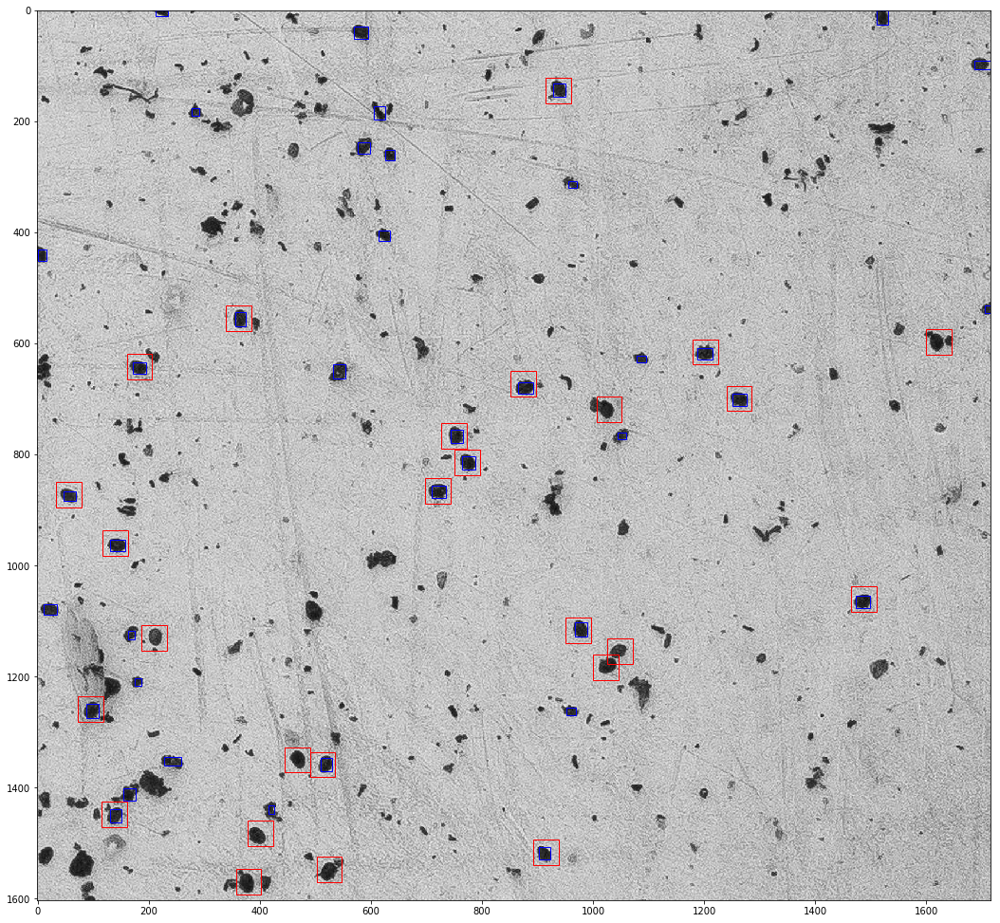

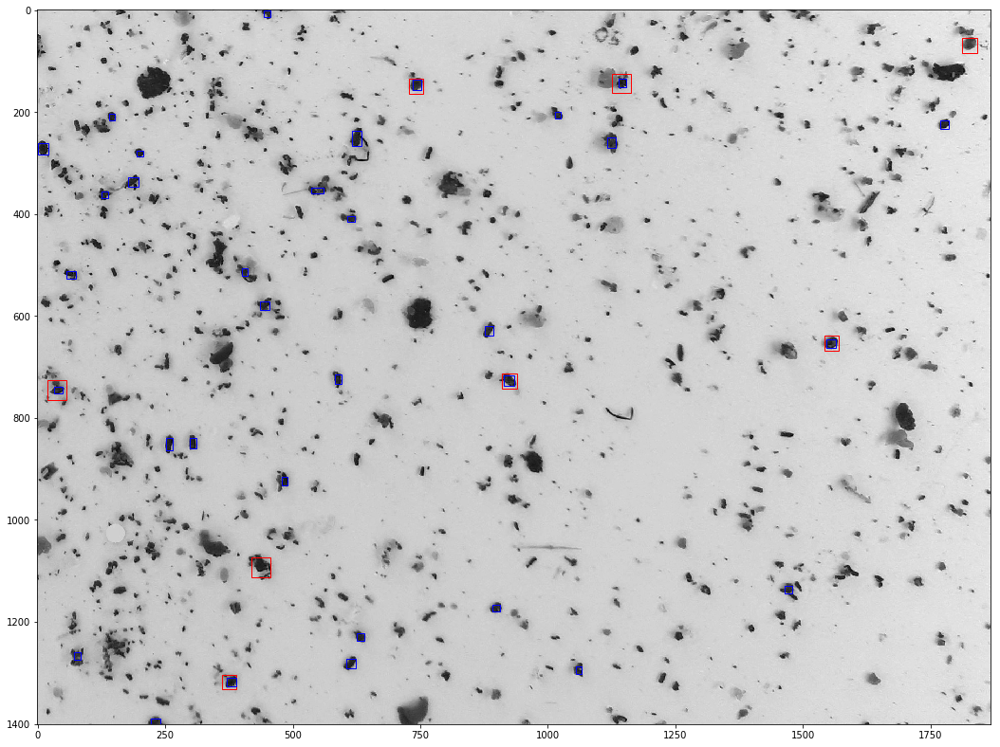

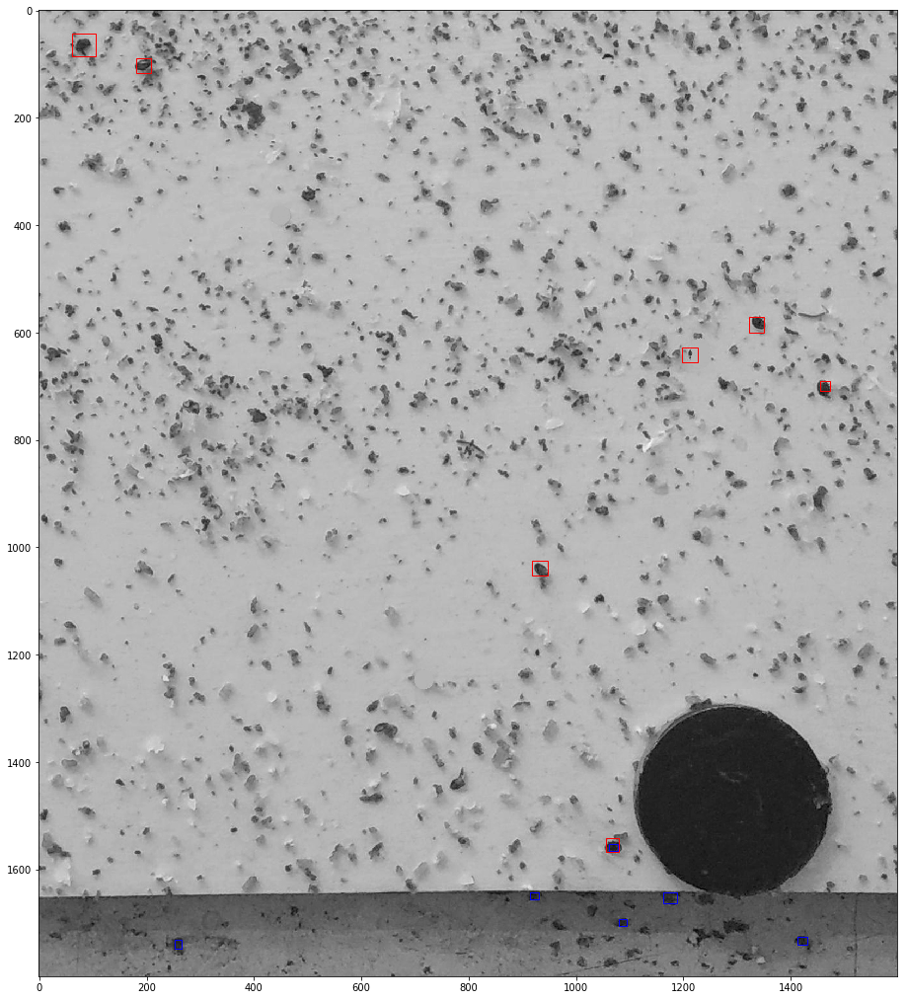

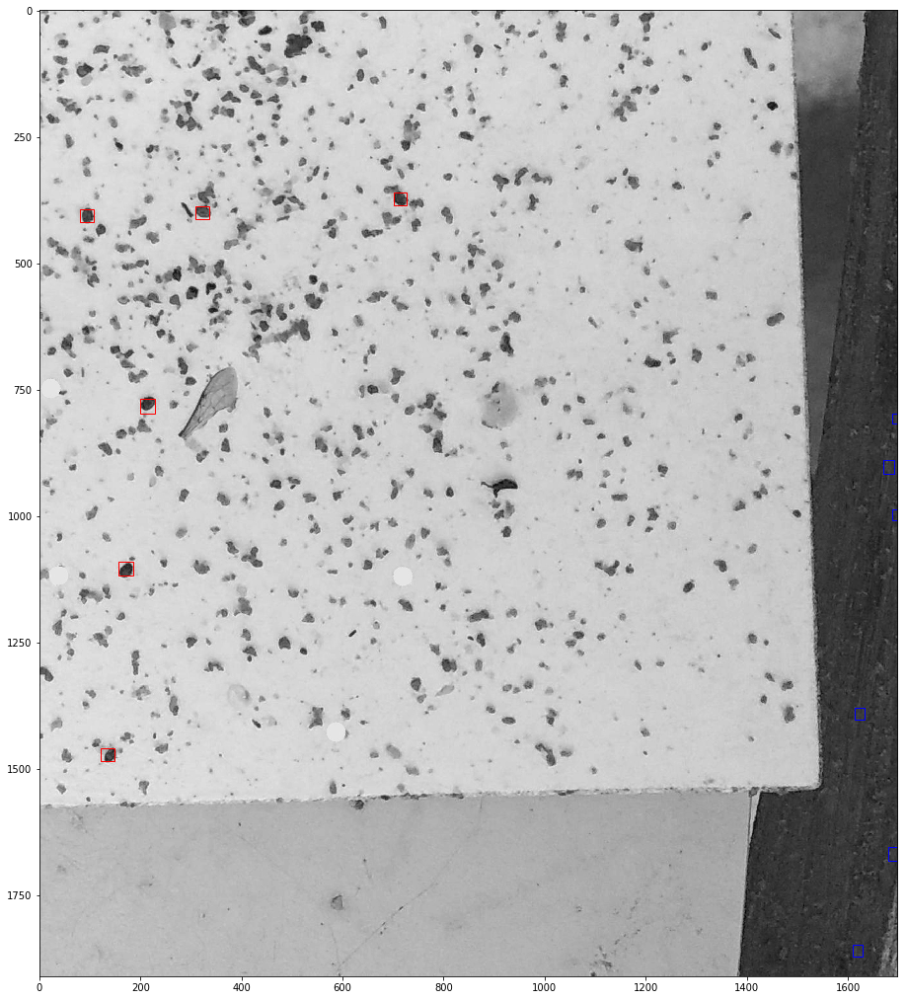

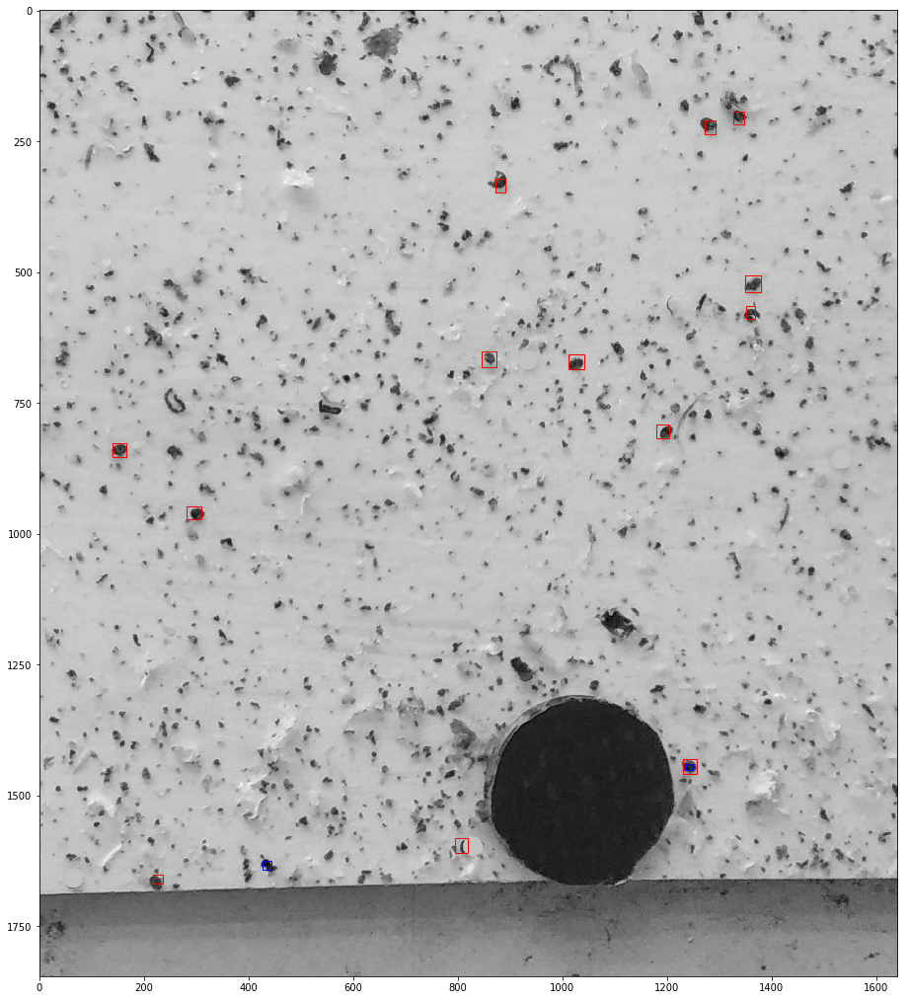

...

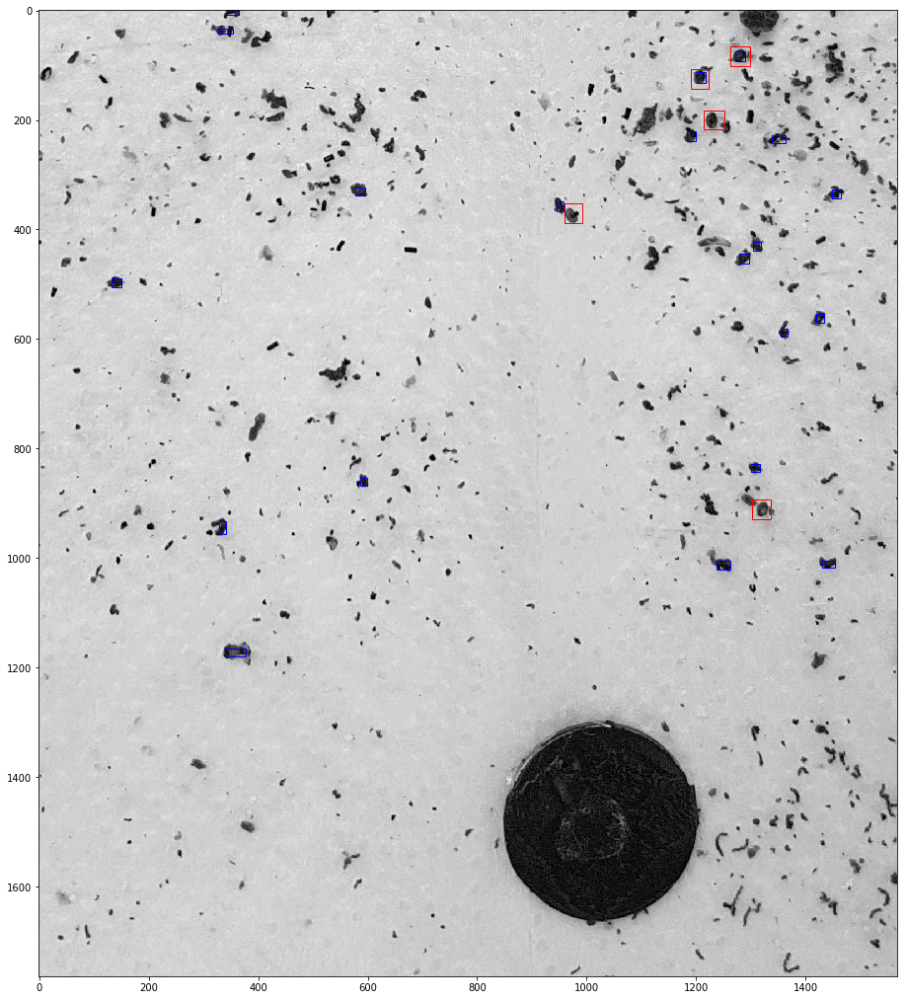

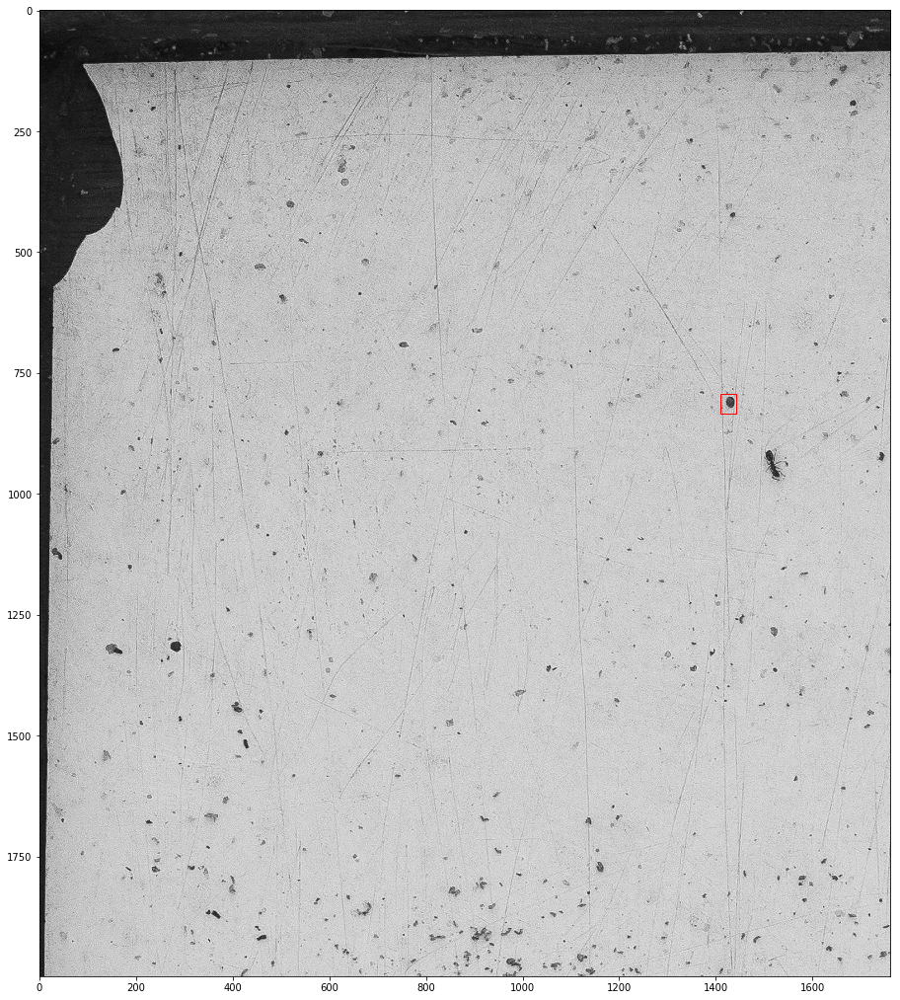

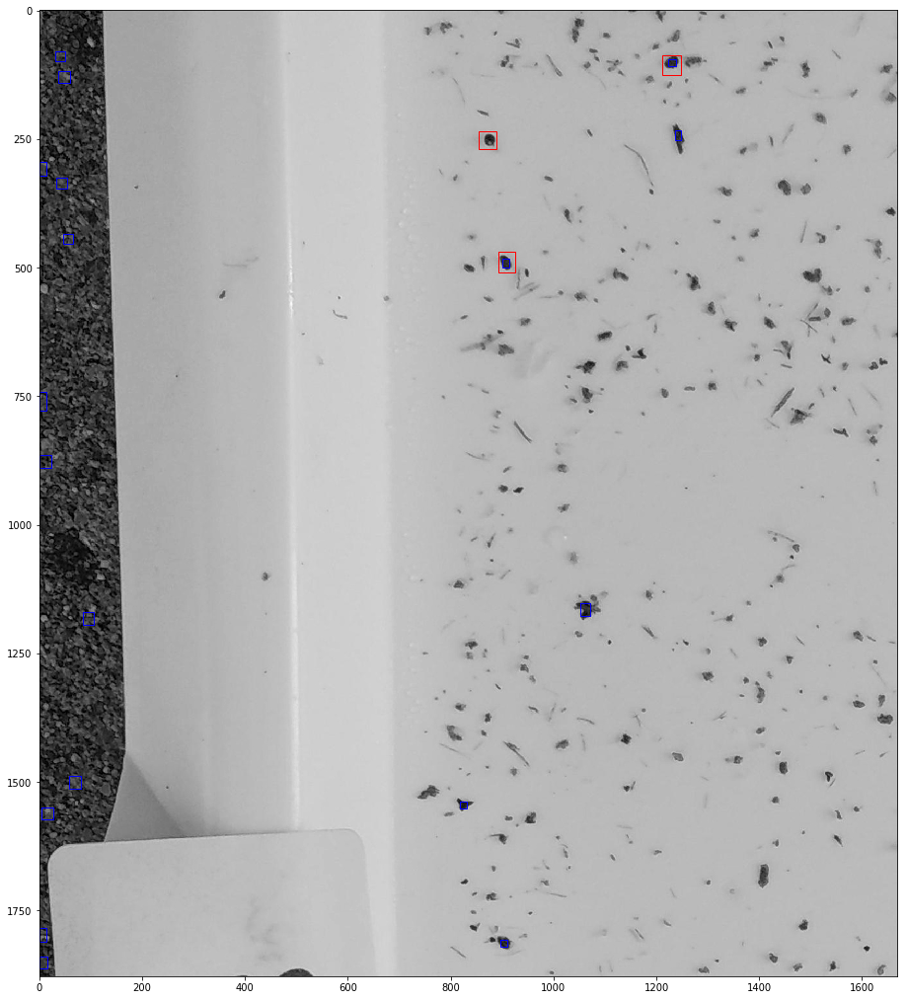

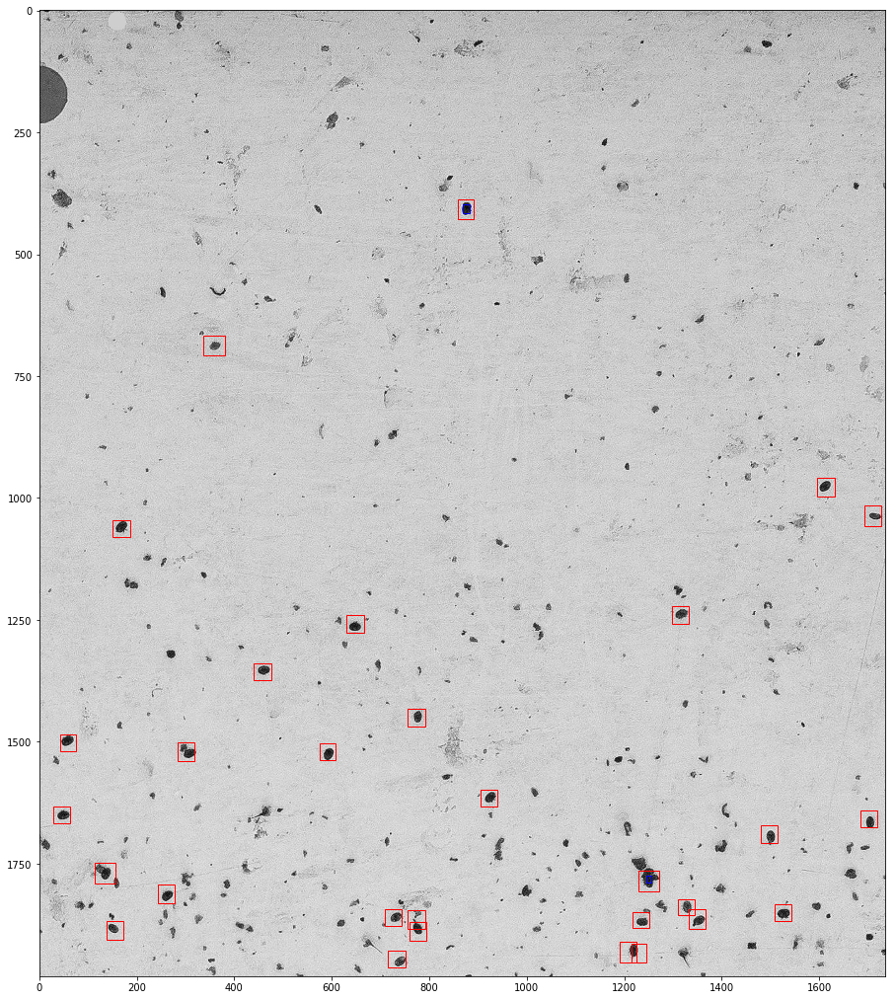

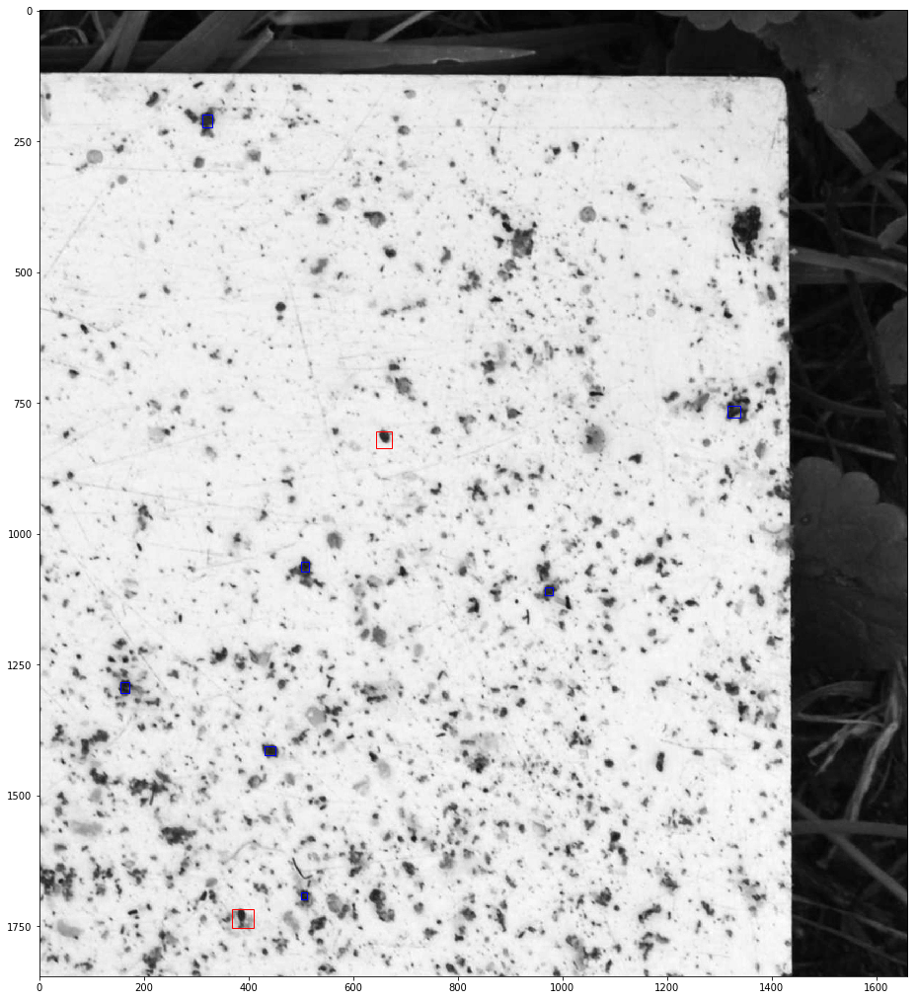

In [20]:
images_names = train_data.filename.unique()

for im in train_perf.sort_values("F1", axis=1).iloc[:,:20]:
    _ = test_values(train_images[int(im)], train_data[train_data['filename'].str.match(images_names[int(im)])],\
                    threshold_value=75, f1_value=15, f2_value=19,plot=True, rand=False)


We identified a few issues: <br>
1. We detect boxes for objects way too big. 
2. We detect boxes that are way too small.
3. Sometimes our detected boxes are way smaller than the ground truth, they get discarded by the IoU threshold.

Hence, to answer point 1. and 2. above, we decided to give a range of acceptable bounding boxe size, which was selected to optimize the F1 on the training and validation set.

#### Validation set performances

We verified the RGB transformation values on the validation set, and the aformentionned parameters 

In [21]:
val_perf = pd.DataFrame(columns=['init'], index=["F1", "Precision", "Recall", "threshold", "f1_val", "f2_val"])
images_names = val_data.filename.unique()
for i in range(0,103):
    val_perf[str(i)] = test_values(val_images[i], val_data[val_data['filename'].str.match(images_names[i])], \
                               threshold_value=75, f1_value=15, f2_value=19, plot=False, rand=False)
    

In [22]:
val_results_df = pd.DataFrame([val_perf.mean(1)[:3],val_perf.std(1)[:3]], \
                                index=["Mean Val", "Std Val"]).T
val_results_df.head()

,Mean Val,Std Val
F1,0.338372,0.299596
Precision,0.321445,0.319438
Recall,0.490589,0.368195


#### Test set performances


In [23]:
test_perf = pd.DataFrame(columns=['init'], index=["F1", "Precision", "Recall", "threshold", "f1_val", "f2_val"])
images_names = val_data.filename.unique()
for i in range(0,33):
    test_perf[str(i)] = test_values(val_images[i], val_data[val_data['filename'].str.match(images_names[i])], \
                               threshold_value=75, f1_value=15, f2_value=19, plot=False, rand=False)
    

In [24]:
test_results_df = pd.DataFrame([test_perf.mean(1)[:3],test_perf.std(1)[:3]], \
                                index=["Mean Test", "Std Test", ]).T
test_results_df.head()

,Mean Test,Std Test
F1,0.358027,0.348160
Precision,0.345024,0.363745
Recall,0.502539,0.411829


### Comparison

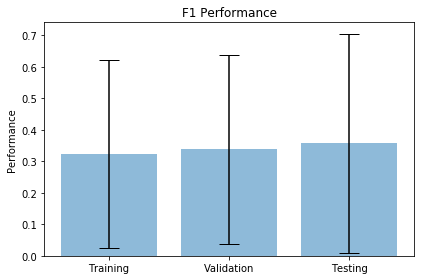

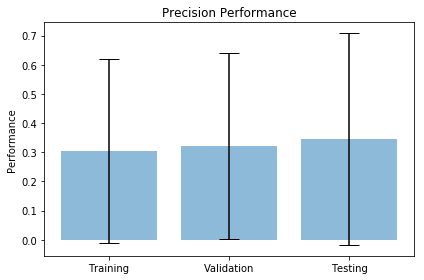

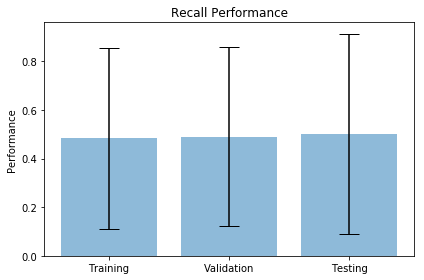

In [26]:
#Plotting mean performance and std
sets = ['Training', 'Validation', 'Testing']
titles = ['F1', 'Precision', 'Recall']
x_pos = np.arange(len(sets))

for i in range(len(titles)):
    means = [train_results_df["Mean Train"][i], val_results_df["Mean Val"][i], test_results_df["Mean Test"][i]]
    error = [train_results_df["Std Train"][i], val_results_df["Std Val"][i], test_results_df["Std Test"][i]]

    fig, ax = plt.subplots()
    ax.bar(x_pos, means, yerr=error, align='center', alpha=0.5, ecolor='black', capsize=10)
    ax.set_ylabel('Performance')
    ax.set_xticks(x_pos)
    ax.set_xticklabels(sets)
    ax.set_title(str( titles[i] +' Performance'))

    plt.tight_layout()
    plt.show()

Overall, our implementation works quite well for a segmentation approach with 0.35 mean F1 score. However, we can see a very high variance. Our implementation tends to have a satisfactory Recall but a bad Precision, it matches too many objects.

## Part 2: Implement your first detector

Write your function(s) for the second part. Feel free to change the name of the function and add your additional functions, but please make sure their input and output follows the mentioned format.

In [ ]:
def detect_by_method_1(img):
    '''
    Input: One single image
    Output: A numpy array containing coordonates of all detected varroas, with the following format: 
            [[x_1, y_1, w_1, h_2], [x_2, y_2, w_1, h_2], ..., [x_n, y_n, w_n, h_n]] 
            where ''n'' is the number of detected varroas.
    '''

    #Your code

Add your implementation. Report the Precision, Recall and F1-score, by using all 50 images of the test-set, and considering 0.3 as the IoU threshold.

In [ ]:
#Your code

## Part 3: Using MLP and CNNs

Add your implementation for the thrid part. Feel free to add your desirable functions, but please make sure you have proper functions for the final detection, where their input and output follows the same format as the previous parts.

In [ ]:
#Your code

## images_names = train_data.filename.unique()
test_values(train_images[2], train_data[train_data['filename'].str.match(images_names[2])])

## Challenge

You can generate a json submission file by using the function ''**generate_pred_json**''. This prediction file can be uploaded online for evaluation (Please refer to section 3 of the project description for more details).

In [ ]:
import numpy as np
import json

def generate_pred_json(data, tag='baseline'):
    '''
    Input
    - data: Is a dictionary d, such that:
          d = { 
              "ID_1": [], 
              "ID_2": [[x_21, y_21, w_21, h_21], [x_22, y_22, w_22, h_22]], 
              ... 
              "ID_i": [[x_i1, y_i1, w_i1, h_i1], ..., [x_iJ, y_iJ, w_iJ, h_iJ]],
              ... 
              "ID_N": [[x_N1, y_N1, w_N1, h_N1]],
          }
          where ID is the string id of the image (e.i. 5a05e86fa07d56baef59b1cb_32.00px_1) and the value the Kx4 
          array of intergers for the K predicted bounding boxes (e.g. [[170, 120, 15, 15]])
    - tag: (optional) string that will be added to the name of the json file.
    Output
      Create a json file, "prediction_[tag].json", conatining the prediction to EvalAI format.
    '''
    unvalid_key = []
    _data = data.copy()
    for key, value in _data.items():
        try:
            # Try to convert to numpy array and cast as closest int
            print(key)
            v = np.around(np.array(value)).astype(int)
            # Check is it is a 2d array with 4 columns (x,y,w,h)
            if v.ndim != 2 or v.shape[1] != 4:
                unvalid_key.append(key)
            # Id must be a string
            if not isinstance(key, str):
                unvalid_key.append(key)
            _data[key] = v.tolist()
        # Deal with not consistant array size and empty predictions
        except (ValueError, TypeError):
            unvalid_key.append(key)
    # Remove unvalid key from dictionnary
    for key in unvalid_key: del _data[key]
    
    with open('prediction_{}.json'.format(tag), 'w') as outfile:
        json.dump(_data, outfile)

In [ ]:
#Your code